# Deep learning for medical imaging

## Practicum 2: Computed Tomography Image Visualisation & Reconstruction
Sep-Oct 2025
==============================================================================================

In this practicum, you will work with several topics covered in the theory sessions. In particular you will (1) simulate a simple and more complex phantoms, (2) apply Radom forward transformation to simulate the computed tomography (CT) projections over a single slice (i.e. sinograms) and (3) reconstruct the original phantom intensity values using different image reconstruction algorithms. In addition, the Shepp–Logan phantom will be used to analyse noise during reconstruction.

### Aims:
- Generate simple and complex phantoms
- Understand the principles of CT image reconstruction using a fan beam geometry with the aid of ``skimage``.
- Be able to generate image projections (i.e. sinograms).
- Reconstruct slices from simple and more complex objects (i.e. Shepp–Logan phantom) using back projection and iterative methods.
- Analyse and compare reconstructed data with ground truth data.
- Observe the difference between ideal (noise free) and noisy image reconstruction.

``Remember to comment your code and provide some discussion on the results obtained for each section.``

In [1]:
%matplotlib inline

In [2]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.transform import radon

### 2.1 Visualise a lung CT dicom image and create a phantom (2 points)

Open and visualise the Lung CT volume stored at the `LungCT-Diagnosis` folder. Read each of the indivdual `dcm` images, and display some 2D slices. Some basic image processing might be needed. Then, create a 3D phantom with the ribcages based on their HU and visualise the 3D rendering. Congratulations, you have created your first anthropomorphic phantom!

<img src='images_4_notebook/LungPhantomImage.png' width="400">


<img src='images_4_notebook/LungPhantomRendering.png' width="400">


Data was taken from https://www.cancerimagingarchive.net/collection/lungct-diagnosis/ 


In [30]:
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt
import pydicom as pdc
from pydicom.filereader import dcmread
from skimage.exposure import rescale_intensity
from skimage.morphology import ball, binary_opening, binary_closing, remove_small_objects
from skimage.measure import marching_cubes
from scipy.ndimage import gaussian_filter
import plotly.graph_objects as go
from skimage.transform import radon, iradon,  resize
from skimage.metrics import mean_squared_error, peak_signal_noise_ratio, structural_similarity

In [ ]:
# ---------- 1) Read DICOM series ----------
DATA_DIR = Path("LungCT-Diagnosis")  # set to your dataset root

def read_series(dicom_dir: Path):
    files = sorted([p for p in dicom_dir.rglob("*.dcm")])
    assert files, f"No DICOMs under {dicom_dir}"
    # read all headers to sort by position or instance
    metas = []
    for f in files:
        ds = dcmread(str(f), stop_before_pixels=True, force=True)
        z = None
        if hasattr(ds, "ImagePositionPatient"):
            z = float(ds.ImagePositionPatient[2])
        inst = int(getattr(ds, "InstanceNumber", 0))
        metas.append((f, z, inst))
    # prefer ImagePositionPatient for sort, else InstanceNumber
    if all(m[1] is not None for m in metas):
        metas.sort(key=lambda x: x[1])
    else:
        metas.sort(key=lambda x: x[2])


# insert your code here
# extending the function to read pixel data, convert to HU, and return 3D array and spacing
def read_series(dicom_dir: Path):
    files = sorted([p for p in dicom_dir.rglob("*.dcm")])
    assert files, f"No DICOMs under {dicom_dir}"
    
    metas = []
    slices = []
    for f in files:
        ds = dcmread(str(f), force=True)
        z = None
        if hasattr(ds, "ImagePositionPatient"):
            z = float(ds.ImagePositionPatient[2])
        inst = int(getattr(ds, "InstanceNumber", 0))
        metas.append((f, z, inst, ds))
    
    # sort by z-position or instance number
    if all(m[1] is not None for m in metas):
        metas.sort(key=lambda x: x[1])
    else:
        metas.sort(key=lambda x: x[2])
    
    # 3D array
    vol = np.stack([m[3].pixel_array for m in metas])
    
    # convert to HU
    ds0 = metas[0][3]
    slope = getattr(ds0, "RescaleSlope", 1.0)
    intercept = getattr(ds0, "RescaleIntercept", 0.0)
    vol_hu = vol.astype(np.float32) * slope + intercept
    
    # voxel spacing
    spacing = (
        float(getattr(ds0, "SliceThickness", 1.0)),
        float(ds0.PixelSpacing[0]),
        float(ds0.PixelSpacing[1])
    )
    
    return vol_hu, spacing

Volume shape: (68, 512, 512)
Voxel spacing: (5.0, 0.830078, 0.830078)


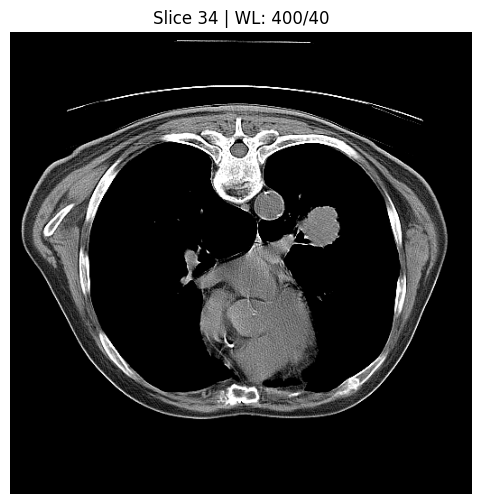

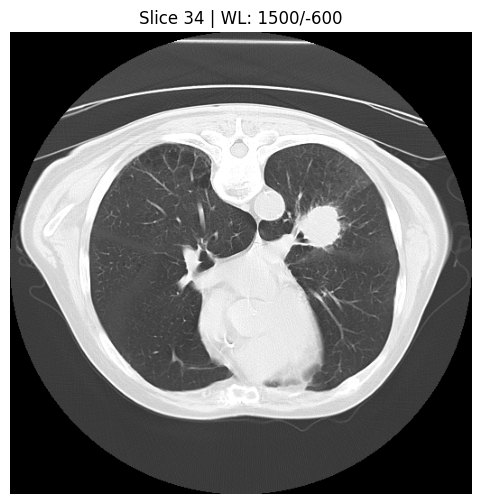

In [55]:
# ---------- 2) 2D visualisation with window/level ----------

# insert your code here
# mediastinum - śródpiersie
# parenchyma - miąższ
# trachea - tchawica
# esophagus - przełyk
# thymus - grasica

# Visualize a single CT slice with window/level.
def show_slice(vol_hu, idx, window=400, level=40):
    img = vol_hu[idx]
    vmin = level - window/2
    vmax = level + window/2
    img_rescaled = np.clip((img - vmin) / (vmax - vmin), 0, 1)
    
    plt.figure(figsize=(6,6))
    plt.imshow(img_rescaled, cmap="gray", origin="lower")
    plt.title(f"Slice {idx} | WL: {window}/{level}")
    plt.axis("off")
    plt.show()

vol_hu, spacing = read_series(DATA_DIR)
print("Volume shape:", vol_hu.shape)
print("Voxel spacing:", spacing)

# show central slice with soft tissue window
show_slice(vol_hu, vol_hu.shape[0]//2, window=400, level=40)

# show lung window
show_slice(vol_hu, vol_hu.shape[0]//2, window=1500, level=-600)

# Observations: Window/Level Effects

**Same axial CT slice**, two displays:

## Soft-tissue window — **WL 400/40**
- Highlights **mediastinum/soft tissue** (heart, vessels).
- **Bones** very bright; fine cortical detail may clip.
- **Lungs** mostly dark with little parenchymal texture.

## Lung window — **WL 1500/−600**
- Highlights **lung parenchyma/airways** (vessels, nodules visible).
- **Mediastinum/soft tissue** washed out.
- Bones bright but not detailed.

**Takeaway:** WL selection controls which tissues are readable; use soft-tissue WL for mediastinum (the central compartment of the thoracic cavity, located between the lungs and behind the breastbone, containing the heart, major blood vessels, trachea, esophagus, thymus, and lymph nodes) and lung WL for parenchyma (the functional tissue of an organ).

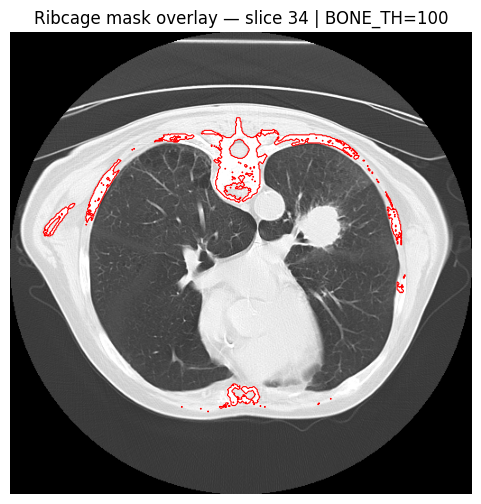

In [ ]:
# ---------- 3) Ribcage phantom via HU threshold ----------
# Simple bone mask. Typical cortical bone > 300 HU.
BONE_TH = 100
bone_mask = vol_hu >= BONE_TH

# insert your code here
vol_hu_smooth = gaussian_filter(vol_hu, sigma=(0.4, 0.6, 0.6))
# air ≈ −1000 HU, lung ≈ −700 HU, soft tissue ≈ 0–80 HU
body_mask = vol_hu > -300
bone_mask &= body_mask

# remove speckles, fill tiny gaps
selem = ball(1)
bone_mask = binary_opening(bone_mask, selem)
bone_mask = binary_closing(bone_mask, selem)

# drop very small connected components
bone_mask = remove_small_objects(bone_mask, min_size=4000)


rib_phantom = bone_mask.astype(np.uint8)

# display with lung window to see ribs around the lungs
vmin, vmax = -600 - 1500/2, -600 + 1500/2
img = np.clip((vol_hu[mid] - vmin) / (vmax - vmin), 0, 1)

plt.figure(figsize=(6,6))
plt.imshow(img, cmap="gray", origin="lower")
plt.contour(rib_phantom[mid], levels=[0.5], linewidths=0.8, colors="r")
plt.title(f"Ribcage mask overlay — slice {mid} | BONE_TH={BONE_TH}")
plt.axis("off")
plt.show()


### Observations — Ribcage phantom via HU threshold
- Light in-plane smoothing stabilizes HU and reduces speckle before thresholding.
- **Low TH (≈100 HU):** more complete but noisy (trabecular bone, calcifications, artifacts).
- **Higher TH (≈200–300 HU):** cleaner cortical bone, fewer false positives, risk of missing thin rib segments.
- Morphology (closing) + `min_size` remove islands and improve rib continuity.

In [ ]:
# ---------- 4) 3D rendering with marching cubes ----------
# Marching cubes expects z-y-x ordering and voxel spacing.

# insert your code here

# binary volume
vol_bin = (rib_phantom > 0).astype(np.uint8)

# Crop to bounding box
coords = np.array(np.where(vol_bin))
z0, y0, x0 = coords.min(axis=1)
z1, y1, x1 = coords.max(axis=1) + 1
pad = 2
z0 = max(0, z0 - pad); y0 = max(0, y0 - pad); x0 = max(0, x0 - pad)
z1 = min(vol_bin.shape[0], z1 + pad)
y1 = min(vol_bin.shape[1], y1 + pad)
x1 = min(vol_bin.shape[2], x1 + pad)

sub = vol_bin[z0:z1, y0:y1, x0:x1]

# binary volume
verts, faces, normals, values = marching_cubes(
    sub, level=0.5, spacing=spacing, allow_degenerate=True
)

# crop origin
origin_shift = np.array([z0*spacing[0], y0*spacing[1], x0*spacing[2]])
verts += origin_shift

# Plotly expects x,y,z
x = verts[:, 2]; y = verts[:, 1]; z = verts[:, 0]

fig = go.Figure(
    data=[go.Mesh3d(
        x=x, y=y, z=z,
        i=faces[:, 0], j=faces[:, 1], k=faces[:, 2],
        color="lightgrey", opacity=1.0, flatshading=True,
        lighting=dict(ambient=0.4, diffuse=0.7, specular=0.15),
        name="Ribcage"
    )]
)
fig.update_layout(
    title="3D Ribcage Phantom — Marching Cubes",
    scene=dict(
        xaxis_title="x (mm)", yaxis_title="y (mm)", zaxis_title="z (mm)",
        aspectmode="data"
    ),
    margin=dict(l=0, r=0, b=0, t=40)
)
fig.show()


### Observations — 3D Ribcage Phantom (Marching Cubes)
  
- Some ribs appear jagged or fragmented due to high HU threshold and segmentation noise.  
- Phantom provides a realistic 3D model suitable for visualization and later reconstruction experiments.  

### 2.2 Create a simple and homogeneous phantom (1.5 points)

Create a more simple 2D phantom which contains a fake lesion as shown below:

<img src='images_4_notebook/PhantomImage.png' width="400">

- Phantom size: 256 x 256 pixels.
- Phantom must contain 3 tissues:
    - Background = 0 pixel intensity value
    - Tissue 1 = 1 (radius = 100 pixels)
    - Tissue 2 (lesion) = 2 (radius = 5 pixels)
    
Help: To create the circunferences, you can use the function ``create_circular_mask``, or define your own function. The lesion could be located in any position within the phantom.

Once constructed, plot the original phantom and a pixel intensity (horizontal) profile along the synthetic lesion. Always remember to include the units of the axis when ploting a graph.

In [ ]:
def create_circular_mask(h, w, center=None, radius=None):

    if center is None: # use the middle of the image
        center = (int(w/2), int(h/2))
    if radius is None: # use the smallest distance between the center and image walls
        radius = min(center[0], center[1], w-center[0], h-center[1])

    Y, X = np.ogrid[:h, :w]
    dist_from_center = np.sqrt((X - center[0])**2 + (Y-center[1])**2)

    mask = dist_from_center <= radius
    return mask
# https://newbedev.com/how-can-i-create-a-circular-mask-for-a-numpy-array

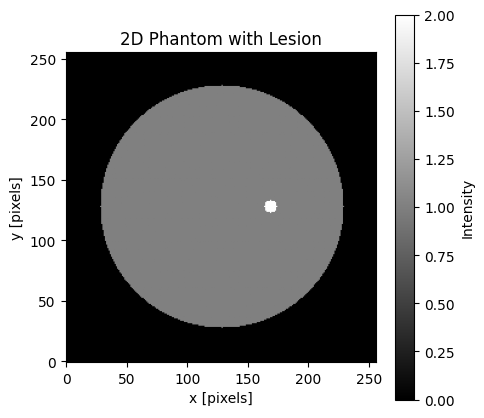

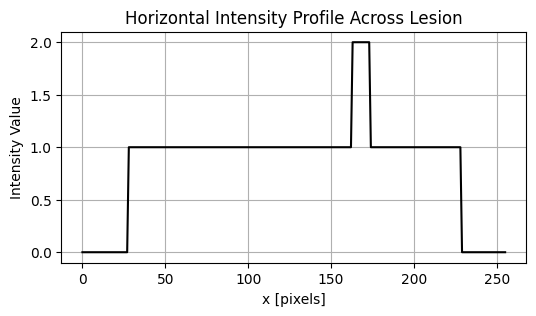

In [ ]:
# insert your code here

phantom_size = 256
phantom = np.zeros((phantom_size, phantom_size), dtype=np.uint8)

# Create large circle
center_big = (phantom_size//2, phantom_size//2)
mask_tissue = create_circular_mask(phantom_size, phantom_size, center=center_big, radius=100)
phantom[mask_tissue] = 1

# Create small circle (lesion)
center_lesion = (phantom_size//2 + 40, phantom_size//2)
mask_lesion = create_circular_mask(phantom_size, phantom_size, center=center_lesion, radius=5)
phantom[mask_lesion] = 2

# Plot phantom
plt.figure(figsize=(5,5))
plt.imshow(phantom, cmap="gray", origin="lower")
plt.title("2D Phantom with Lesion")
plt.axis("on")
plt.xlabel("x [pixels]")
plt.ylabel("y [pixels]")
plt.colorbar(label="Intensity")
plt.show()

# Plot horizontal profile
row = phantom_size//2
plt.figure(figsize=(6,3))
plt.plot(np.arange(phantom_size), phantom[row, :], "-k")
plt.title("Horizontal Intensity Profile Across Lesion")
plt.xlabel("x [pixels]")
plt.ylabel("Intensity Value")
plt.grid(True)
plt.show()

### 2.3 Create the projections of the phantom (2 points)

Generate the projections of the previously generated 2D phantom using the ``radon`` transform from ``skimage.transform``. Play with the different parameters to optimise sinogram. Then, show the sinogram of the projections.

In this section, considered the following approch:

Use different number of projections (i.e. 4, 20, 50, 100, 200, 300, 360) considering that in all cases the simulated projections cover the 360º. For example, 100 projections are taken in the range from 0º to 360º.


``Questions``: How do the sinograms changes with number of projections? What is the effect of increasing/decrasing the number of projections? 

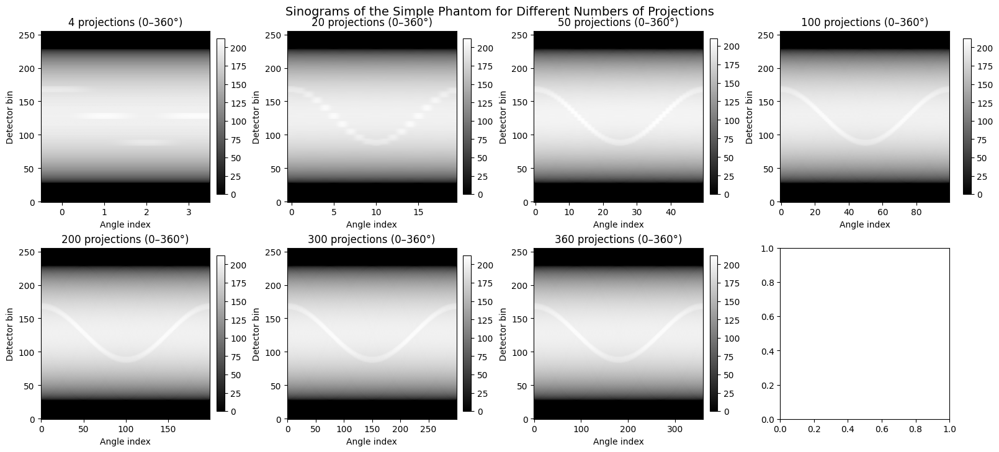

In [23]:
# insert your code here

angles_list = [4, 20, 50, 100, 200, 300, 360]
fig, axes = plt.subplots(2, 4, figsize=(16, 7), constrained_layout=True)
axes = axes.ravel()

for i, n in enumerate(angles_list):
    theta = np.linspace(0, 360, n, endpoint=False)
    sino = radon(img, theta=theta, circle=True)
    ax = axes[i]
    im = ax.imshow(sino, cmap="gray", aspect="auto", origin="lower")
    ax.set_title(f"{n} projections (0–360°)")
    ax.set_xlabel("Angle index")
    ax.set_ylabel("Detector bin")
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.04)

plt.suptitle("Sinograms of the Simple Phantom for Different Numbers of Projections", y=1.02, fontsize=14)
plt.show()

### Observations — Sinograms of the Simple Phantom

- **Few angles (4–20):** sinogram is sparse, lesion trace appears coarse and blocky.  
- **Medium angles (50–100):** sinogram becomes smoother, sinusoidal trace of lesion clearly visible.  
- **High angles (200–360):** further smoothness, but improvements are marginal compared to 100–200.  
- **Overall:** increasing projections improves sampling and reconstruction quality, but after ~200 angles gains are minor.

### 2.4 Reconstruction with Filtered Back Projection (FBP) (2.5 points)

FBP is one of the most simple reconstruction methods to reconstruct images in CT. Explore the ``iradon`` from ``skimage.transform`` using the different filters available (Ramp filter (default), Shepp-logan, Cosine, Hamming, Hann). 

Make use of the ``matplotlib`` to show the original and reconstructed images of the phantom and compare the pixel intensity signal across the lesion profile (similarly to section 2.1).In addition, provide evaluation metric you could consider useful for this purpose (image difference, mean square error (MSE), peak signal to noise ratio (PSNR), structural index similarity (SSIM), etc.). Then, discuss the results.

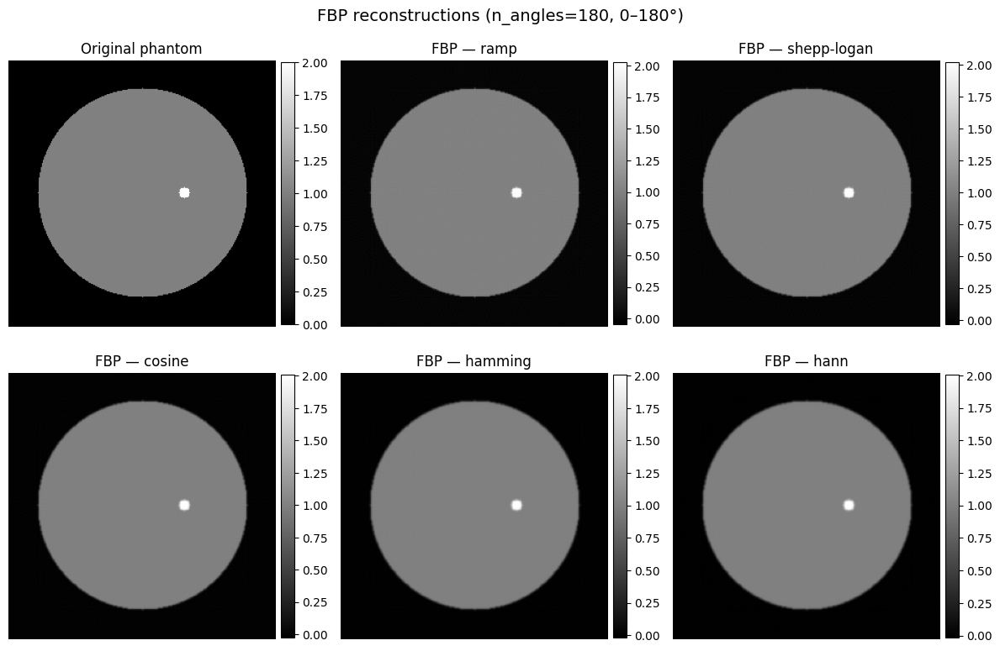

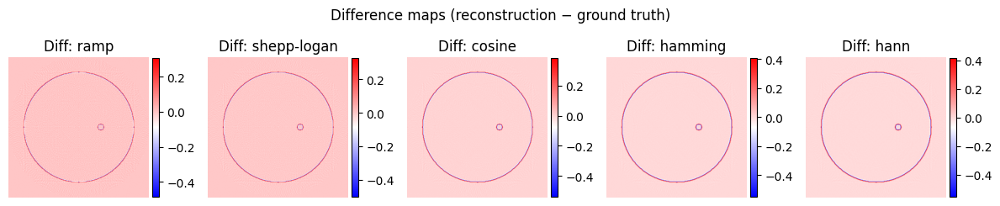

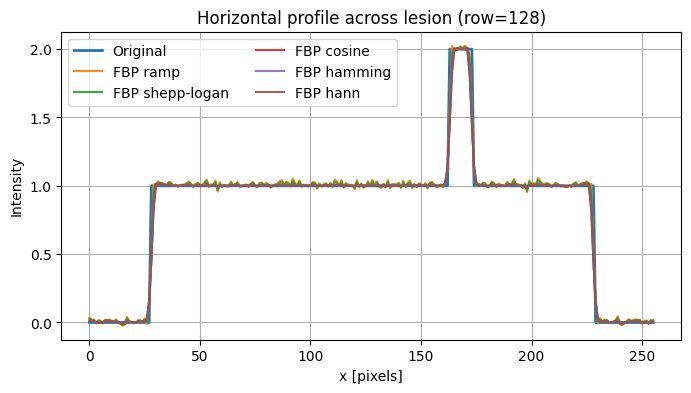

Filter		MSE		PSNR (dB)	SSIM
ramp        	0.00099	36.08		0.9621
shepp-logan 	0.00116	35.39		0.9704
cosine      	0.00162	33.93		0.9769
hamming     	0.00193	33.15		0.9752
hann        	0.00205	32.90		0.9747


In [27]:
# insert your code here

# sinogram
n_angles = 180
theta = np.linspace(0, 180, n_angles, endpoint=False)
sino = radon(phantom.astype(float), theta=theta, circle=True)

# FBP
filters = ["ramp", "shepp-logan", "cosine", "hamming", "hann"]
recons = {}
metrics = []

data_range = phantom.max() - phantom.min()

for f in filters:
    rec = iradon(sino, theta=theta, filter_name=f, circle=True)
    recons[f] = rec
    mse  = mean_squared_error(phantom, rec)
    psnr = peak_signal_noise_ratio(phantom, rec, data_range=data_range)
    ssim = structural_similarity(phantom, rec, data_range=data_range)
    metrics.append((f, mse, psnr, ssim))

cols = 3
rows = int(np.ceil((len(filters)+1)/cols))
plt.figure(figsize=(12, 4*rows))
# original
ax = plt.subplot(rows, cols, 1)
im = ax.imshow(phantom, cmap="gray", origin="lower")
ax.set_title("Original phantom")
ax.axis("off")
plt.colorbar(im, ax=ax, fraction=0.046, pad=0.02)

# recons
for i, f in enumerate(filters, start=2):
    ax = plt.subplot(rows, cols, i)
    im = ax.imshow(recons[f], cmap="gray", origin="lower")
    ax.set_title(f"FBP — {f}")
    ax.axis("off")
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.02)

plt.suptitle(f"FBP reconstructions (n_angles={n_angles}, 0–180°)", y=0.98, fontsize=14)
plt.tight_layout()
plt.show()

# difference maps
plt.figure(figsize=(12, 2.8))
for i, f in enumerate(filters, start=1):
    ax = plt.subplot(1, len(filters), i)
    diff = recons[f] - phantom
    im = ax.imshow(diff, cmap="bwr", origin="lower")
    ax.set_title(f"Diff: {f}")
    ax.axis("off")
    plt.colorbar(im, ax=ax, fraction=0.046, pad=0.02)
plt.suptitle("Difference maps (reconstruction − ground truth)", y=0.95)
plt.tight_layout()
plt.show()

# horizontal profile
row = phantom.shape[0] // 2
x = np.arange(phantom.shape[1])

plt.figure(figsize=(8, 4))
plt.plot(x, phantom[row, :], label="Original", linewidth=2)
for f in filters:
    plt.plot(x, recons[f][row, :], label=f"FBP {f}", alpha=0.9)
plt.title(f"Horizontal profile across lesion (row={row})")
plt.xlabel("x [pixels]")
plt.ylabel("Intensity")
plt.grid(True)
plt.legend(ncol=2)
plt.show()

# metrics table
print("Filter\t\tMSE\t\tPSNR (dB)\tSSIM")
for f, mse, psnr, ssim in metrics:
    print(f"{f:12s}\t{mse:.5f}\t{psnr:.2f}\t\t{ssim:.4f}")

### Observations — FBP Reconstruction

- All filters successfully reconstruct the phantom and lesion.
- **Ramp filter:** sharpest edges, best PSNR (36 dB), but slightly more ringing noise.  
- **Shepp-Logan:** balanced, smooth image with good SSIM.  
- **Hann:** smoother images, edges appear slightly blurred, gives highest SSIM (>0.97). 

### 2.5 Sheep logan phantom (2 points)

So far we have used a quite simple phantom with only 2 tissues. Now, repeat the prior analysis for the **noisy sinogram** for one case (approach, filter,...) using a (slightly) more advanced head test object, the Sheep-logan phantom. Do you observe particular differences between the reconstrucction results from both phantoms? 


<img src='images_4_notebook/SheepLoganPhantom.png' width="1000">



In order to create **noisy sinograms**, you can add Poison noise (``np.random.poisson``; perhaps with lam = 10) to your noise-free sinograms (not to the image!) and reconstruct the phantom images with the different filters. Plot the reconstruction image and the (horizontal) intensity profile along specific row. Then, comment on the effects of the filters on the reconstructed phatom images.


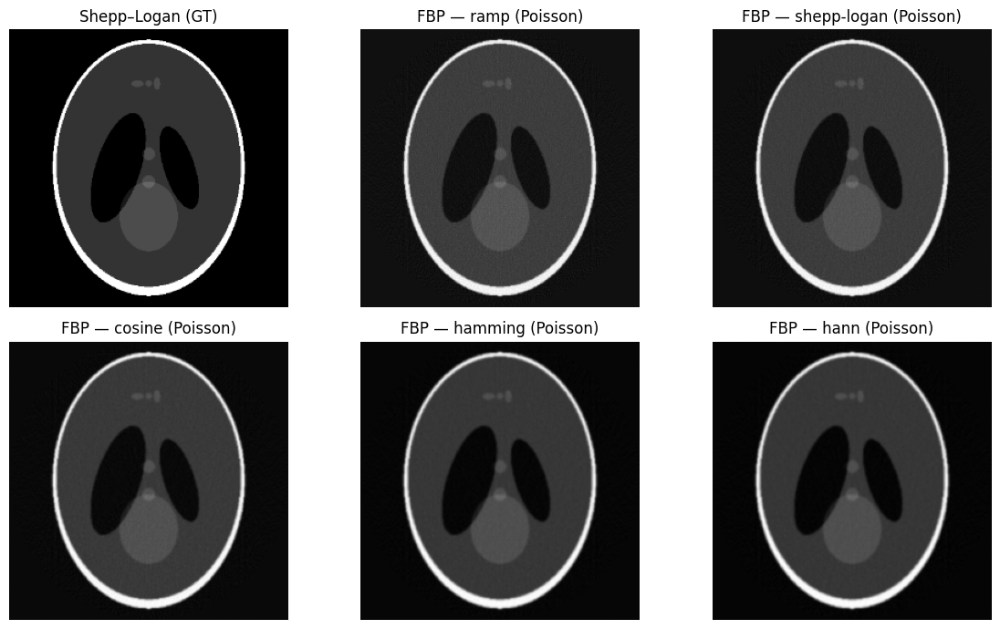

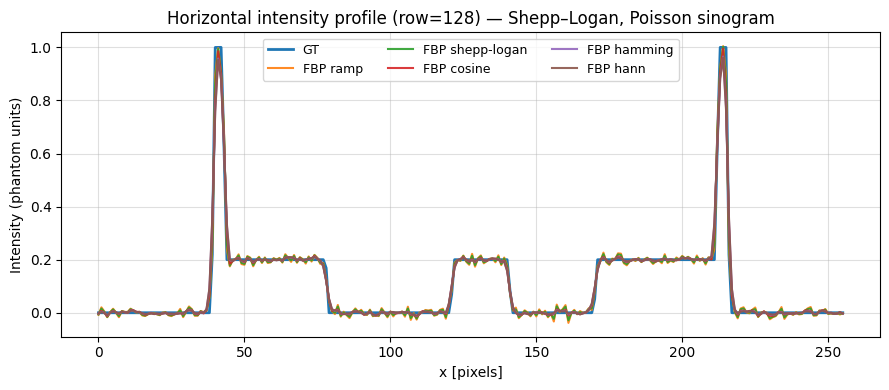

In [ ]:
from skimage.data import shepp_logan_phantom

logan_phantom = shepp_logan_phantom()


# insert your code here
N = 256
x = resize(logan_phantom, (N, N), anti_aliasing=True).astype(float)

# attenuation coefficients (promieniowanie)
atten_scale = 0.05
x = x * atten_scale
# clean line integrals
n_angles = 180
theta = np.linspace(0, 180, n_angles, endpoint=False)
p = radon(x, theta=theta, circle=True)

# forward transmission
I0 = 5e4
I_clean = I0 * np.exp(-p)
I_meas = np.random.poisson(I_clean)
I_meas = np.clip(I_meas, 1, None)
p_noisy = -np.log(I_meas / I0)

# FBP
filters = ["ramp", "shepp-logan", "cosine", "hamming", "hann"]
recs = {f: iradon(p_noisy, theta=theta, filter_name=f, circle=True) for f in filters}

# show
fig, axes = plt.subplots(2, 3, figsize=(12,7))
axes = axes.ravel()
axes[0].imshow(x/atten_scale, cmap="gray", origin="lower"); axes[0].set_title("Shepp–Logan (GT)")
axes[0].axis("off")
for i, f in enumerate(filters, start=1):
    axes[i].imshow(recs[f]/atten_scale, cmap="gray", origin="lower")
    axes[i].set_title(f"FBP — {f} (Poisson)"); axes[i].axis("off")
plt.tight_layout(); plt.show()

# horizontal profile
row = N // 2
xpix = np.arange(N)

plt.figure(figsize=(9, 4))
plt.plot(xpix, (x/atten_scale)[row], label="GT", linewidth=2)

for f in filters:
    plt.plot(xpix, (recs[f]/atten_scale)[row], label=f"FBP {f}", alpha=0.9)

plt.title(f"Horizontal intensity profile (row={row}) — Shepp–Logan, Poisson sinogram")
plt.xlabel("x [pixels]")
plt.ylabel("Intensity (phantom units)")
plt.grid(True, alpha=0.4)
plt.legend(ncol=3, fontsize=9)
plt.tight_layout()
plt.show()

### Observations — Shepp–Logan Phantom with Poisson Noise

- All filters reconstruct the main head structures correctly, despite noise.  
- **Ramp** filter keeps edges sharpest but amplifies noise/streaks.  
- **Shepp-Logan, Cosine, Hamming, Hann** suppress noise more effectively, producing smoother images but slightly blurred edges.  
- Horizontal profiles show all filters recover correct intensity levels; main differences lie in edge sharpness vs. smoothness.  

### 2.6 Deep learning challenge (optional)
If you like this topic and want to explore deep learning (DL) approaches for CT image reconstruction, I encourage you to look at this **ICASSP-2024 3D-CBCT challenge** to advance the frontiers of DL for low-dose 3D cone-beam CT reconstruction at https://sites.google.com/view/icassp2024-spgc-3dcbct